In [122]:
using Pkg
Pkg.activate(@__DIR__)
Pkg.instantiate()
using Revise, Distributions, GLMakie, Dates, DataFrames, CSV, BenchmarkTools, DataFramesMeta, LinearAlgebra, FFTW
using TrypColonies
import Serialization as s
Makie.inline!(true)  

  Activating project at `c:\Users\Andreas\Dropbox\phd\TrypColonies\TrypColonies`


true

### Choose local or static external data

In [107]:
data_path = find_data_path(local_data = false)

"C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\"

In [12]:
data_base = s.deserialize("data_base\\df.jls") 
data_base = @subset(data_base, :location .== data_path)   
@transform!(data_base, :doubling_time = 1 ./log2.(1 .+:growth_rate) ./3600)
last(data_base, 5)

Row,radius_tanget,scale_fac,agent_number,noise_dis,velo_var_relative,sweep_parameter,sampling_interval,L,path,walker_step_size,unix_date,run_time,location,name,N,parameter_increment,Diff_coe,adsorption_rate,storage,noise_strength,grid_recover_rate,iterations,growth_rate,Diameter_colony,parameter_steps,velocity_dis,radius_collision,date,walker_speed_phy,decay_rate,grid_strength,total_time,doubling_time,Δt_walker_min
,Int64,Int64,Int64,UnionAll,Float64,String,Int64,Tuple…,String?,Int64,Float64?,Float64?,String?,String?,Tuple…,Float64,Float64,Float64,Float64?,Float64,Float64,Int64,Float64?,Float64,Int64,UnionAll,Int64,DateTime?,Float64,Float64,Int64,Float64,Float64?,Float64?
1,15,4,250000,Normal,1.5,noise_strength,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\Noise_correct_growth_rate_250000_time_seed_0941,3,1.7469e9,93812.5,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,Noise_correct_growth_rate,"(1000, 1000)",0.05,7.0e-11,1.0e-5,68.2726,0.0,6.66667,1,2.13937e-5,0.003,16,Normal,16,2025-05-10T18:53:52.369,5.0e-6,0.001,8000,37000.0,9.0,0.1
2,15,4,250000,Normal,1.5,Δt_walker_min,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\turning_rate_correct_noise_250000_time_seed_5076,3,1.74743e9,96388.9,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,turning_rate_correct_noise,"(1000, 1000)",0.02,7.0e-11,1.0e-5,68.1727,0.2,6.66667,1,2.13937e-5,0.003,16,Normal,16,2025-05-16T21:37:47.518,5.0e-6,0.001,8000,37000.0,9.0,0.0
3,15,4,250000,Normal,1.5,Δt_walker_min,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\Diff_coe_lower_250000_time_seed_4971,3,1.74762e9,31706.1,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,Diff_coe_lower,"(1000, 1000)",0.005,7.0e-11,1.0e-5,21.3048,0.2,6.66667,1,2.13937e-5,0.003,5,Normal,16,2025-05-19T01:04:39.319,5.0e-6,0.001,8000,37000.0,9.0,0.0
4,15,4,250000,Normal,1.5,Δt_walker_min,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\Turning_rate_low_noise_03_250000_time_seed_0641,3,1.74772e9,29354.3,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,Turning_rate_low_noise_03,"(1000, 1000)",0.005,7.0e-11,1.0e-5,21.3586,0.3,6.66667,1,2.13937e-5,0.003,5,Normal,16,2025-05-20T05:46:37.546,5.0e-6,0.001,8000,37000.0,9.0,0.0
5,15,4,250000,Normal,1.5,Diff_coe,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\Diff_coe_lower_250000_time_seed_2551,3,1.74775e9,72000.0,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,Diff_coe_lower_250000,"(1000, 1000)",5.0e-12,1.0e-12,1.0e-5,34.1682,0.2,6.66667,1,2.13937e-5,0.003,8,Normal,16,2025-05-20T13:24:34.449,5.0e-6,0.001,8000,37000.0,9.0,0.1


### Chose the Data Sets based on some conditions 

In [13]:
data_base

Row,radius_tanget,scale_fac,agent_number,noise_dis,velo_var_relative,sweep_parameter,sampling_interval,L,path,walker_step_size,unix_date,run_time,location,name,N,parameter_increment,Diff_coe,adsorption_rate,storage,noise_strength,grid_recover_rate,iterations,growth_rate,Diameter_colony,parameter_steps,velocity_dis,radius_collision,date,walker_speed_phy,decay_rate,grid_strength,total_time,doubling_time,Δt_walker_min
,Int64,Int64,Int64,UnionAll,Float64,String,Int64,Tuple…,String?,Int64,Float64?,Float64?,String?,String?,Tuple…,Float64,Float64,Float64,Float64?,Float64,Float64,Int64,Float64?,Float64,Int64,UnionAll,Int64,DateTime?,Float64,Float64,Int64,Float64,Float64?,Float64?
1,1,4,250000,Normal,1.5,radius_tanget,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\radius_tanget_sweep_threading_16_32_250000_time_seed_3543,3,1.73843e9,76925.0,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,radius_tanget_sweep_threading_16_32,"(1000, 1000)",2.0,7.0e-11,0.001,65.2002,1.2,15.0,1,1.157e-5,0.003,16,Normal,12,2025-02-01T17:34:38.663,5.0e-6,0.001,350,36000.0,16.6415,missing
2,15,4,250000,Normal,1.5,grid_recover_rate,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\grid_recover_rate_hard_walls_sweep_threading_16_32_250000_time_seed_1530,3,1.73937e9,71941.2,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,grid_recover_rate_hard_walls_sweep_threading_16_32,"(1000, 1000)",2.0,7.0e-11,0.001,65.1372,1.2,10.0,1,1.157e-5,0.003,16,Normal,12,2025-02-12T15:17:53.336,5.0e-6,0.001,1000,36000.0,16.6415,missing
3,15,4,250000,Normal,1.5,adsorption_rate,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\adsorption_right_noise_very_hard_walls_sweep_threading_16_32_250000_time_seed_3435,3,1.73996e9,68009.3,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,adsorption_right_noise_very_hard_walls_sweep_threading_16_32,"(1000, 1000)",5.0e-5,7.0e-11,1.0e-5,65.1349,1.2,15.0,1,1.157e-5,0.003,16,Normal,14,2025-02-19T10:37:26.282,5.0e-6,0.001,8000,36000.0,16.6415,missing
4,15,4,250000,Normal,1.5,grid_recover_rate,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\grid_recover_small_adsoprtion_sweep_threading_16_32_250000_time_seed_3676,3,1.74005e9,65499.8,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,grid_recover_small_adsoprtion_sweep_threading_16_32,"(1000, 1000)",1.0,7.0e-11,1.0e-5,65.1565,1.2,10.0,1,1.157e-5,0.003,16,Normal,14,2025-02-20T10:59:38.328,5.0e-6,0.001,8000,36000.0,16.6415,missing
5,15,4,250000,Normal,1.5,radius_collision,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\radisu_collision_random_movement_sweep_threading_16_32_250000_time_seed_3854,3,1.74014e9,65967.0,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,radisu_collision_random_movement_sweep_threading_16_32,"(1000, 1000)",1.0,7.0e-11,1.0e-5,65.1882,2.2,15.0,1,1.157e-5,0.003,16,Normal,6,2025-02-21T12:10:23.668,5.0e-6,0.001,8000,36000.0,16.6415,missing
6,15,4,250000,Normal,1.5,radius_collision,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\radisu_collision_random_movement_modified_collision_sweep_threading_16_32_250000_time_seed_7315,3,1.74022e9,65754.7,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,radisu_collision_random_movement_modified_collision_sweep_threading_16_32,"(1000, 1000)",1.0,7.0e-11,1.0e-5,65.1855,2.2,15.0,1,1.157e-5,0.003,16,Normal,6,2025-02-22T11:17:52.284,5.0e-6,0.001,8000,36000.0,16.6415,missing
7,15,4,250000,Normal,1.5,radius_collision,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\radisu_collision_random_movement_diamond_collision_sweep_threading_16_32_250000_time_seed_8444,3,1.74117e9,65217.5,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,radisu_collision_random_movement_diamond_collision_sweep_threading_16_32,"(1000, 1000)",1.0,7.0e-11,1.0e-5,65.1859,2.2,15.0,1,1.157e-5,0

In [19]:
data_used = DataFrame(data_base[[40,34,35],:])

Row,radius_tanget,scale_fac,agent_number,noise_dis,velo_var_relative,sweep_parameter,sampling_interval,L,path,walker_step_size,unix_date,run_time,location,name,N,parameter_increment,Diff_coe,adsorption_rate,storage,noise_strength,grid_recover_rate,iterations,growth_rate,Diameter_colony,parameter_steps,velocity_dis,radius_collision,date,walker_speed_phy,decay_rate,grid_strength,total_time,doubling_time,Δt_walker_min
,Int64,Int64,Int64,UnionAll,Float64,String,Int64,Tuple…,String?,Int64,Float64?,Float64?,String?,String?,Tuple…,Float64,Float64,Float64,Float64?,Float64,Float64,Int64,Float64?,Float64,Int64,UnionAll,Int64,DateTime?,Float64,Float64,Int64,Float64,Float64?,Float64?
1,15,4,250000,Normal,1.5,Diff_coe,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\Diff_coe_lower_250000_time_seed_2551,3,1.74775e9,72000.0,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,Diff_coe_lower_250000,"(1000, 1000)",5.0e-12,1.0e-12,1.0e-5,34.1682,0.2,6.66667,1,2.13937e-5,0.003,8,Normal,16,2025-05-20T13:24:34.449,5.0e-6,0.001,8000,37000.0,9.0,0.1
2,15,4,250000,Normal,1.5,Diff_coe,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\Diff_coe_increase_diamond&circle_gradient_grid_250000_time_seed_7872,3,1.74594e9,98803.3,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,Diff_coe_increase_diamond&circle_gradient_grid,"(1000, 1000)",1.0e-10,7.0e-11,1.0e-5,65.6414,0.2,6.66667,1,2.13937e-5,0.003,16,Normal,16,2025-04-29T14:24:37.512,5.0e-6,0.001,8000,36000.0,9.0,0.1
3,15,4,250000,Normal,1.5,Diff_coe,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\Diff_coe_increase_bigger_diamond&circle_gradient_grid_250000_time_seed_7265,3,1.74635e9,2.35877e5,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,Diff_coe_increase_bigger_diamond&circle_gradient_grid,"(1000, 1000)",1.0e-9,1.0e-9,1.0e-5,67.5549,0.2,6.66667,1,2.13937e-5,0.003,16,Normal,16,2025-05-04T10:05:45.165,5.0e-6,0.001,8000,37000.0,9.0,0.1


### Chose analysis function of agents

An analysis function has to directly work on the .jls files and return a object per .jls file that can be plotted afterwards.  

In [20]:
path_vec = create_data_path_vector(data_used.path);

## One iteration 

In [21]:
s_p = data_used.sweep_parameter[1]
p_s = data_used.parameter_steps[1]
iter = data_used.iterations[1]
time_point = round(Int, data_used.total_time[1]/data_used.sampling_interval[1])
println(s_p)
println("total_time: ",data_used.total_time[1],"[s]", "   sampling_interval: ",data_used.sampling_interval[1],"[s]", "    time_points: ",time_point)
println("Para_Steps:",p_s)
println("Iterations:",iter)  

Diff_coe
total_time: 37000.0[s]   sampling_interval: 1200[s]    time_points: 31
Para_Steps:8
Iterations:1


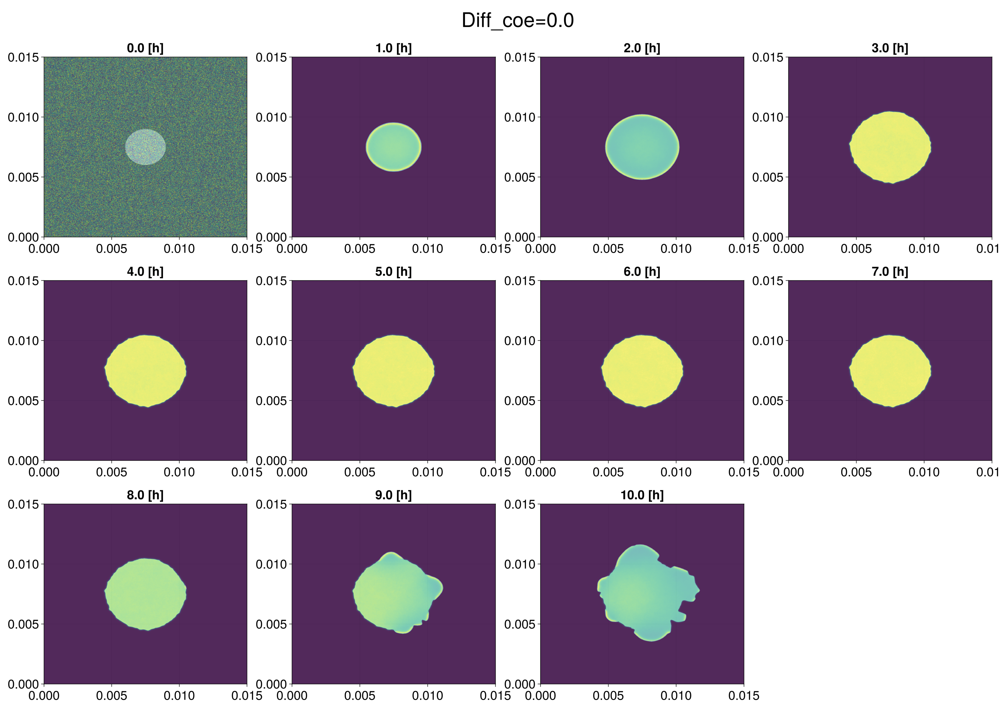

In [23]:
it = 1 * data_used.iterations[1] 
data = s.deserialize(path_vec[1][it])
range = 1:3:length(data[1])
plt_n = 1
update_theme!(Theme(fontsize = 25))

size = size = res_scaling(length(range), factor = 2.0 , plots = plt_n,plots_per_row = 4) 

fig = Figure(size  = size)

c = 0
for i in range 
    ax = Axis(fig[c÷4+1,(c%4+1)],title = "$(round(data_used.sampling_interval[1]*(i-1)/3600,digits = 2)) [h]") 
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][i]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][i], colormap = (:viridis,0.6))
    c += 1  
end

#supertitle = Label(fig[0, :], "Doubling time = $(doubling_time[it]) [h]", fontsize = 50)

supertitle = Label(fig[0, :], "$(s_p)=$(round(getproperty(data[4].pa_ph,Symbol(s_p)),digits =3))", fontsize = 40)

display(fig)
mkpath(data_used.path[1]*"\\analysis\\single")
save(data_used.path[1]*"\\analysis\\single\\heatmap_2h_$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p))).png", fig, px_per_unit = 2, size = size)


# Compare data in one sweep


In [32]:
time_points = round.(Int, data_used.total_time ./ data_used.sampling_interval)


3-element Vector{Int64}:
 31
 30
 31

In [24]:
s_p = data_used.sweep_parameter[1]
p_s = data_used.parameter_steps[1]
iter = data_used.iterations[1]
time_point = round(Int, data_used.total_time[1]/data_used.sampling_interval[1])
println(s_p)
println("total_time: ",data_used.total_time[1],"[s]", "   sampling_interval: ",data_used.sampling_interval[1],"[s]", "    time_points: ",time_point)
println("Para_Steps:",p_s)
println("Iterations:",iter)  

Diff_coe
total_time: 37000.0[s]   sampling_interval: 1200[s]    time_points: 31
Para_Steps:8
Iterations:1


In [26]:
it_u = data_used.iterations[1]  
plt_n = 3

para_range = Int[]
data_r = Int[]

for i in  1:length(path_vec)
    for j in 1:data_used.parameter_steps[i]
        push!(para_range, j)
        push!(data_r, i)
    end
end

para_range

40-element Vector{Int64}:
  1
  2
  3
  4
  5
  6
  7
  8
  1
  2
  3
  4
  5
  ⋮
  5
  6
  7
  8
  9
 10
 11
 12
 13
 14
 15
 16

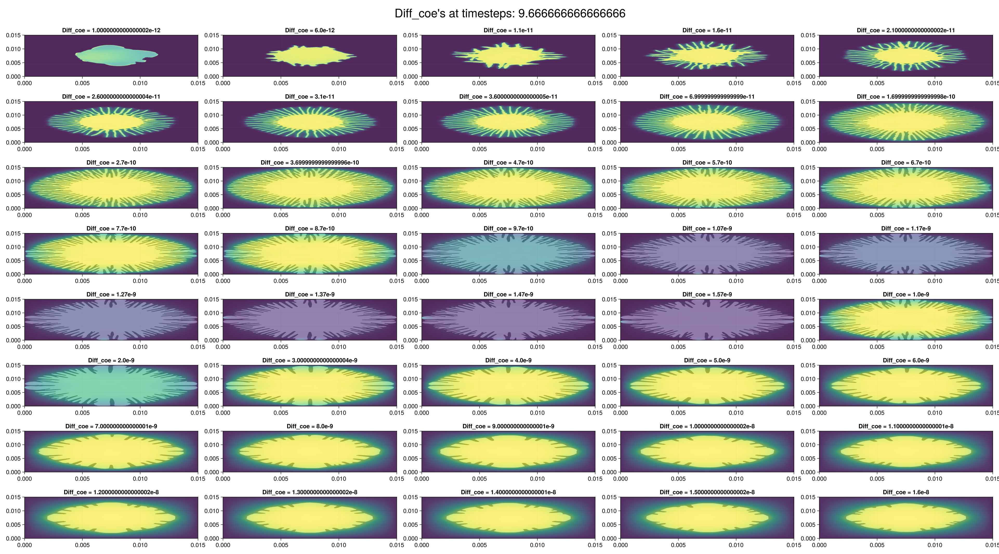

In [28]:
update_theme!(Theme(fontsize = 15))
time_point = 30
size  = res_scaling(length(para_range), factor = 3 , plots = 1)
fig3 = Figure(size = size)
c = 0
for (i,p) in enumerate(para_range)
    data = s.deserialize(path_vec[data_r[i]][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig3[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[data_r[i]]*(p-1)+data_used[!,s_p][data_r[i]])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1 
end

supertitle = Label(fig3[0, :], " $(s_p)'s at timesteps: $((time_point -1) *data_used.sampling_interval[1]/3600)", fontsize = 30)
display(fig3)

mkpath(data_used.path[1]*"\\analysis")
save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_only_heat_all.png", fig3, size = size)

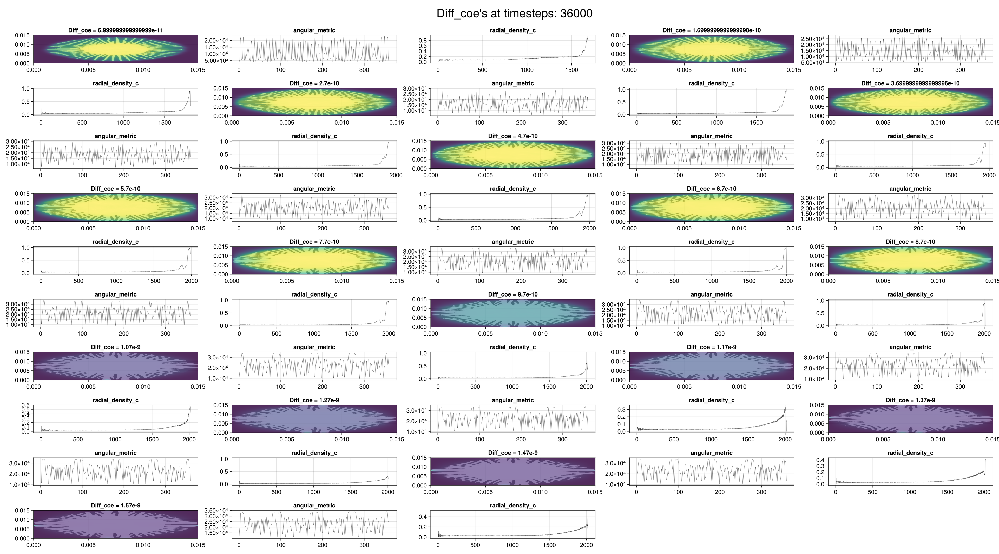

In [39]:
update_theme!(Theme(fontsize = 15))

size  = res_scaling(length(para_range), factor = 3 , plots = plt_n)
fig3 = Figure(size = size)
c = 0
for p in para_range
    data = s.deserialize(path_vec[1][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig3[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
    ax2 = Axis(fig3[c÷5+1,(c%5+1)], title = "angular_metric")
    lines!(ax2, angular_metric(datu[time_point]...), color = :black, linewidth = .3)
    c += 1  
    ax3 = Axis(fig3[c÷5+1,(c%5+1)], title = "radial_density_c")
    lines!(ax3, radial_density_c(datu[time_point]...), color = :black, linewidth = .3)
    c += 1 
end

supertitle = Label(fig3[0, :], " $(s_p)'s at timesteps: $(time_point *data_used.sampling_interval[1])", fontsize = 30)
display(fig3)

mkpath(data_used.path[1]*"\\analysis")
save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_angular_radial.png", fig3, size = size)

## Area gain and adsorpted material 

update_theme!(Theme(fontsize = 15))

size = res_scaling(length(para_range), factor = 3 , plots = plt_n)
fig4 = Figure(size = size)
c = 0
for p in para_range
    data = s.deserialize(path_vec[1][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig4[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
    ax2 = Axis(fig4[c÷5+1,(c%5+1)], title = "relative area increase", xlabel = "time [h]")
    scatterlines!(ax2,(1:length(datu)).*(1/3), [area_gain(x...) for x in datu], color = :black, linewidth = .3)
    c += 1  
    ax3 = Axis(fig4[c÷5+1,(c%5+1)], title = "adsorbed_material",xlabel = "time [h]")
    scatterlines!(ax3, (1:length(datu)).*(1/3),[adsorbed_material(x...) for x in datu], color = :black, linewidth = .3)
    c += 1 
end

supertitle = Label(fig4[0, :], "$(s_p)'s at timesteps: $(time_point *data_used.sampling_interval[1])", fontsize = 30)
display(fig4)


mkpath(data_used.path[1]*"\\analysis")
save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_area_adsorbed.png", fig4, size = size)

## Area gain and cell growth 

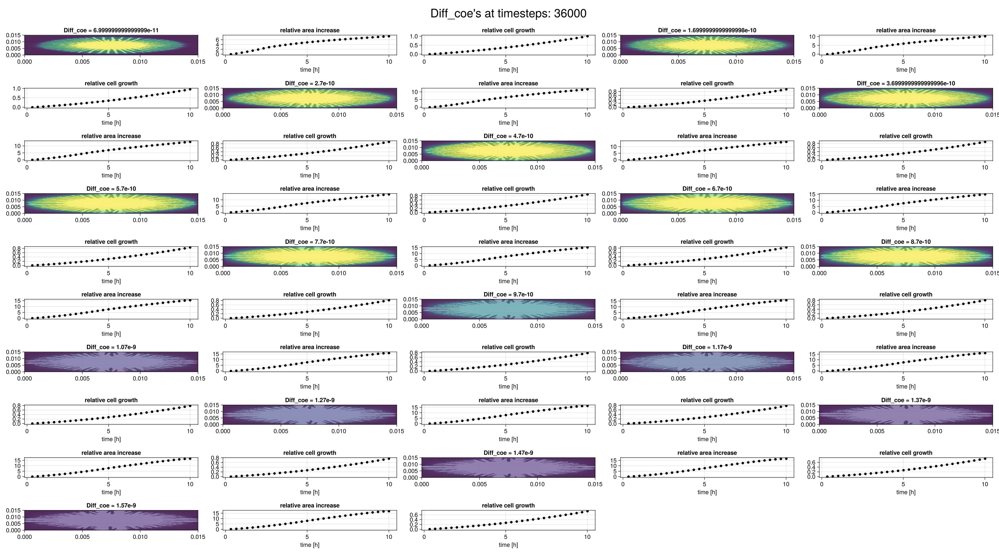

In [40]:
size = res_scaling(length(para_range), factor = 3 , plots = plt_n)
fig5 = Figure(size = size)
c = 0
for p in para_range
    data = s.deserialize(path_vec[1][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig5[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
    ax2 = Axis(fig5[c÷5+1,(c%5+1)], title = "relative area increase", xlabel = "time [h]")
    scatterlines!(ax2,(1:length(datu)).*(1/3) ,[area_gain(x...) for x in datu], color = :black, linewidth = .3)
    c += 1  
    ax3 = Axis(fig5[c÷5+1,(c%5+1)], title = "relative cell growth",xlabel = "time [h]")
    scatterlines!(ax3,(1:length(datu)).*(1/3), [cell_gain(x...) for x in datu], color = :black, linewidth = .3)
    c += 1 
end

supertitle = Label(fig5[0, :], "$(s_p)'s at timesteps: $(time_point *data_used.sampling_interval[1])", fontsize = 30)
display(fig5)


mkpath(data_used.path[1]*"\\analysis")
save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_area__cells_adsorbed.png", fig5, size = size)

## Metrics

Custom para range for the spefically analyses data points. 

In [35]:
it_u = data_used.iterations[1]  
plt_n = 3

para_range = Int[]
data_r = Int[]

for i in  1:length(path_vec)
    for j in 1:data_used.parameter_steps[i]
        push!(para_range, j)
        push!(data_r, i)
    end
end

para_range;

In [43]:
para_range = [ 2, 5,1,9,9 ]
data_r = [ 1, 1,2,2,3] 


5-element Vector{Int64}:
 1
 1
 2
 2
 3

In [47]:
it_u = data_used.iterations[1]  

data = s.deserialize(path_vec[1][1*it_u])
datu = transform_data(data)
Og_size = og_size(datu[1]...) 

plt_n = 3
length_data = round(Int,data_used.total_time[1]/data_used.sampling_interval[1])
length_data = 30

30

In [48]:
angular_metric_vec = [[zeros(Int, 360) for i in 1:length_data] for j in 1:length(para_range)];
pair_metric_vec = [[zeros(Float64, 360) for i in 1:length_data] for j in 1:length(para_range)];
area_gain_vec = [[0.0 for i in 1:length_data] for j in 1:length(para_range)];
cell_gain_vec = [[0.0 for i in 1:length_data] for j in 1:length(para_range)];
adsorbed_material_vec = [[0.0 for i in 1:length_data] for j in 1:length(para_range)];
length(angular_metric_vec);

## Create Data

In [49]:
Threads.@threads for (i,x) in collect(enumerate(para_range))
    data = s.deserialize(path_vec[data_r[i]][x*it_u])
    datu = transform_data(data)
    pair_metric_vec[i] = [pair_cor_metric(datu[j]... ; max_samples = 10000000) for j in 1:length_data]
end

In [50]:
Threads.@threads for (i,x) in collect(enumerate(para_range))
    data = s.deserialize(path_vec[data_r[i]][x*it_u])
    datu = transform_data(data)
    angular_metric_vec[i] = [angular_metric(datu[j]...) for j in 1:length_data]
    area_gain_vec[i] = [area_gain(datu[j]...) for j in 1:length_data]
end

In [51]:
Threads.@threads for (i,x) in collect(enumerate(para_range))
    data = s.deserialize(path_vec[data_r[i]][x*it_u])
    datu = transform_data(data)
    adsorbed_material_vec[i] = [adsorbed_material(datu[j]...) for j in 1:length_data]
    cell_gain_vec[i] = ([cell_gain(datu[j]...) for j in 1:length_data].+1)*data_used.agent_number[1]
end

In [52]:
#doubling_time = string.(round.([1 ./log2.(1 .+data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1]) ./3600 for p in para_range], digits = 4)  )
Para_name = "Diff. coeff."


"Diff. coeff."

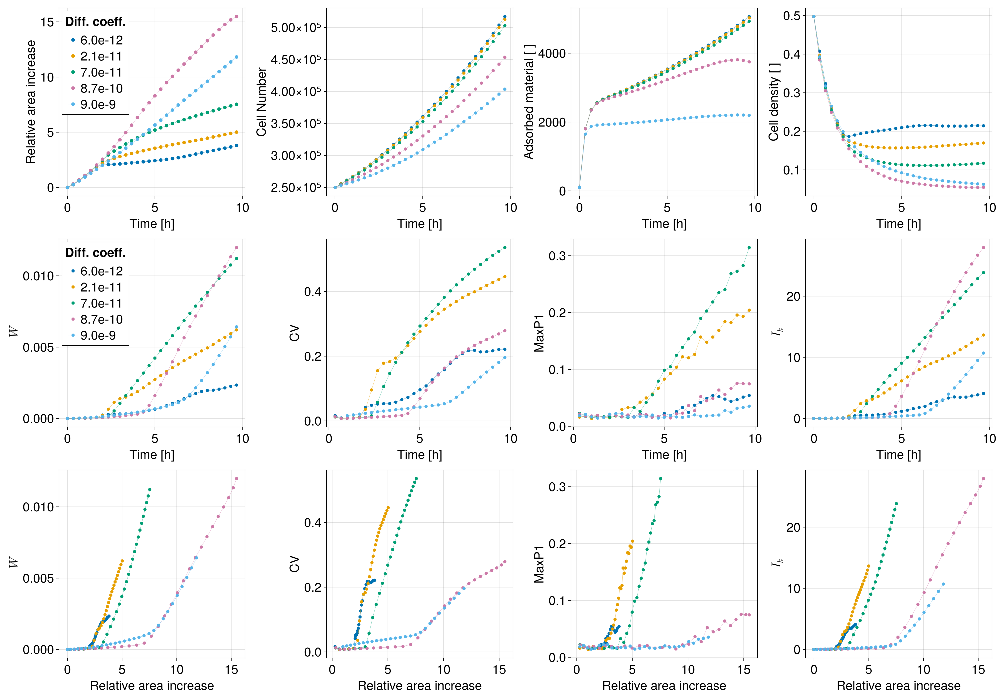

In [105]:
Para_name = "Diff. coeff."

update_theme!(Theme(fontsize = 25))


size = (2000, 1400)
fig6 = Figure(size = size)
ax = Axis(fig6[1,1], ylabel = "Relative area increase", xlabel = "Time [h]")
ax1 = Axis(fig6[1,2], ylabel = "Cell Number", xlabel = "Time [h]")
ax1_1 = Axis(fig6[1,3], ylabel = "Adsorbed material [ ]", xlabel = "Time [h]")
ax1_2 = Axis(fig6[1,4], ylabel = "Cell density [ ]", xlabel = "Time [h]")

ax2 = Axis(fig6[2,1], ylabel = L"W", xlabel = "Time [h]")
ax3 = Axis(fig6[2,2], ylabel = "CV", xlabel = "Time [h]")
ax4 = Axis(fig6[2,3], ylabel = "MaxP1", xlabel = "Time [h]")
ax5 = Axis(fig6[2,4], ylabel = L"I_k", xlabel = "Time [h]")


ax6 = Axis(fig6[3,1], ylabel = L"W", xlabel = "Relative area increase")
ax7 = Axis(fig6[3,2], ylabel = "CV", xlabel = "Relative area increase")
ax8 = Axis(fig6[3,3], ylabel = "MaxP1", xlabel = "Relative area increase")
ax9 = Axis(fig6[3,4], ylabel = L"I_k", xlabel = "Relative area increase")

samp_fac = data_used.sampling_interval[1] /3600


samp_fac = data_used.sampling_interval[1] /3600
time_x = (0:length_data-1).*samp_fac
l_t = length(time_x)

for (i,p) in enumerate(para_range)
    metric_single =angular_metric_vec[i]
    label_s = "$(round(data_used.parameter_increment[data_r[i]]*(p-1)+data_used[!,s_p][data_r[i]], sigdigits =3))"
    # normalize by area 
    
    scatterlines!(ax, time_x, area_gain_vec[i][1:l_t], linewidth = .3, label= label_s,markersize  = 10) 
    scatterlines!(ax1, time_x, cell_gain_vec[i][1:l_t], linewidth = .3, label= label_s)
    scatterlines!(ax1_1, time_x, adsorbed_material_vec[i][1:l_t], linewidth = .3, label= label_s)
    scatterlines!(ax1_2, time_x, cell_gain_vec[i][1:l_t]./((area_gain_vec[i][1:l_t].+1)*Og_size), linewidth = .3, label= label_s)


    scatterlines!(ax2, time_x,[roughness(x,Og_size) for x in metric_single], linewidth = .3, label= label_s) 
    if i < 5
        scatterlines!(ax3, time_x, [std(x)/mean(x) for x in metric_single], linewidth = .3, label= label_s) 
    else
        scatterlines!(ax3, time_x[4:l_t], [std(x)/mean(x) for x in metric_single][4:l_t], linewidth = .3, label= label_s) 
    end
    scatterlines!(ax4, time_x, [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]], linewidth = .3, label= label_s) 
    scatterlines!(ax5, time_x, [fourier_ik(x,Og_size) for x in metric_single], linewidth = .3, label= label_s) 


    scatterlines!(ax6, area_gain_vec[i],[roughness(x,Og_size) for x in metric_single], linewidth = .3, label= label_s)
    if i < 5
        scatterlines!(ax7, area_gain_vec[i], [std(x)/mean(x) for x in metric_single], linewidth = .3, label= label_s)
    else
        scatterlines!(ax7, area_gain_vec[i][4:end], [std(x)/mean(x) for x in metric_single][4:end], linewidth = .3, label= label_s)
    end
    scatterlines!(ax8, area_gain_vec[i], [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]], linewidth = .3, label= label_s)
    scatterlines!(ax9, area_gain_vec[i], [fourier_ik(x,Og_size) for x in metric_single], linewidth = .3, label= label_s)
end

"""
axislegend(ax,"$(s_p)", position = :lt)
axislegend(ax2,"$(s_p)", position = :lt)
"""


axislegend(ax,"$(Para_name)", position = :lt)
axislegend(ax2, "$(Para_name)", position = :lt)
#axislegend(ax6, "$(Para_name)", position = :lt)


save(data_used.path[1]*"\\analysis\\roughness_all.png", fig6, size = size)
fig6

In [124]:
D(r) = 1.38*10^(-23) * 290 / (0.001*6.0 * pi * r) # diffusion coefficent 

D (generic function with 1 method)

In [125]:
ra(D) = 1.38*10^(-23) * 290 / (0.001*6.0 * pi * D)

ra (generic function with 1 method)

In [152]:
rh2(M) = ((3*0.001*M)/(10 *π *6.022*10^23))^(1/3) *0.01# hydrodynamic radius

rh2 (generic function with 1 method)

In [161]:
rh2(1690)*2

1.0227910116191655e-8

In [126]:
D(3*10^(-9)) # diffusion coefficent 

7.07708980281961e-11

In [127]:
D(5*10^(-8)) # diffusion coefficent   

4.2462538816917666e-12

In [128]:
r = logrange(2e-11, 5e-7, 1000) # logrange

1000-element Base.LogRange{Float64, Base.TwicePrecision{Float64}}:
 2.0e-11, 2.02038e-11, 2.04096e-11 … 4.89965e-7, 4.94957e-7, 5.0e-7

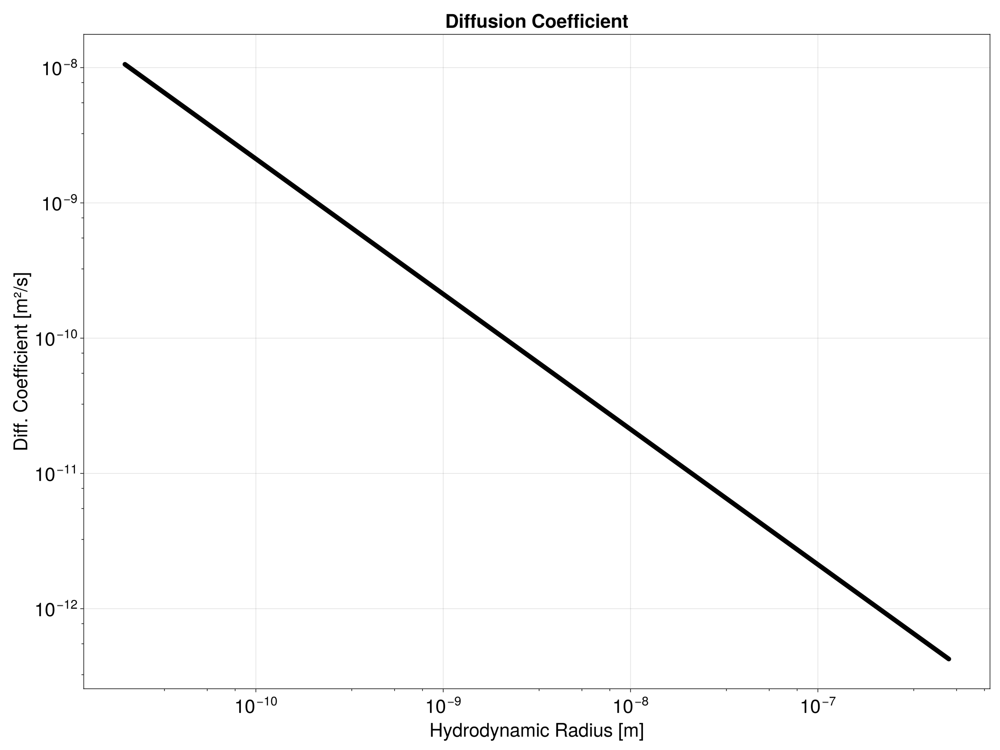

In [116]:
d_s = D.(r) # diffusion coefficent
update_theme!(Theme(fontsize = 30))


fig = Figure(size = (1600, 1200))
ax = Axis(fig[1, 1], title = "Diffusion Coefficient", xlabel = "Hydrodynamic Radius [m]", ylabel = "Diff. Coefficient [m²/s]", 
xscale = log10, yscale = log10,xticks=LogTicks(WilkinsonTicks(6, k_min=4)), xminorticksvisible = true,
    xminorticks = IntervalsBetween(4),yminorticksvisible = true,yminorticks = IntervalsBetween(4),yticks=LogTicks(WilkinsonTicks(6, k_min=5)))
scatterlines!(ax, r, d_s, markersize = 10.5, color = :black)

save(data_used.path[1]*"\\analysis\\diffusion_coeff.png", fig, size = (1600, 1200))
fig

In [62]:
 10 .^ range(-1, -6,length=500)

LoadError: MethodError: objects of type StepRange{Int64, Int64} are not callable
Use square brackets [] for indexing an Array.
The object of type `StepRange{Int64, Int64}` exists, but no method is defined for this combination of argument types when trying to treat it as a callable object.

In [97]:
12*1200/3600

4.0

In [ ]:
para_range = [1, 2, 3,5,8,1,4,9,5,9 ]
data_r = [1, 1, 1,1,1,2,2,2,3,3] 


5-element Vector{Int64}:
 1
 4
 9
 5
 9

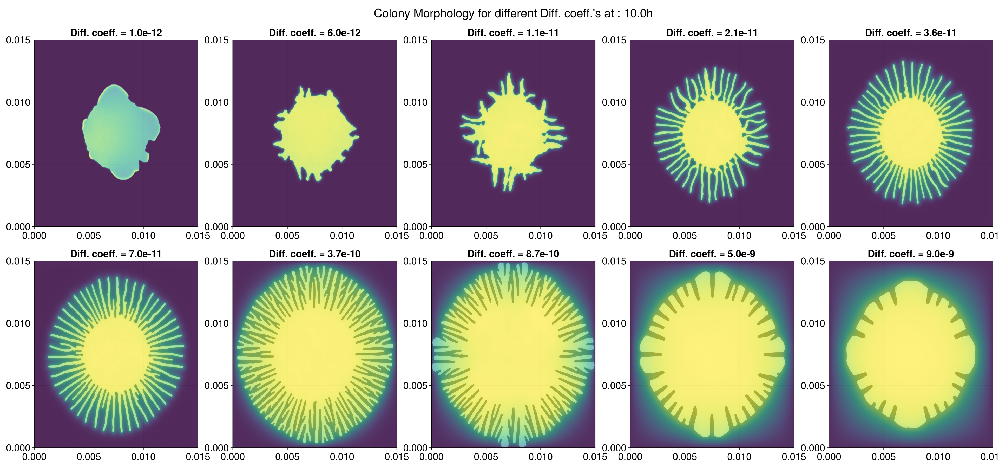

In [42]:
size = size = (3000, 1200)
update_theme!(Theme(fontsize = 25))

#d = length(para_range)
d  = 5
time_point = 30

fig8 = Figure(size = size)
c = 0
for (i,p) in enumerate(para_range)
    data = s.deserialize(path_vec[data_r[i]][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig8[c÷d+1,(c%d+1)], title = "$(Para_name) = $(round(data_used.parameter_increment[data_r[i]]*(p-1)+data_used[!,s_p][data_r[i]],sigdigits  = 3))")
    if p == 16
        time_point = 12
    end
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
end

time_point = 31
supertitle = Label(fig8[0, :], "Colony Morphology for different $(Para_name)'s at : $((time_point-1) *(data_used.sampling_interval[1])/3600)h", fontsize = 30)
display(fig8)

save(data_used.path[1]*"\\analysis\\final_state.png", fig8)


In [104]:
round(10.0001^-10, sigdigits=3)

1.0e-10

In [ ]:
size = (2400, 600)
fig6 = Figure(size = size)
ax = Axis(fig6[1,1], ylabel = "Relative area increase", xlabel = "Time [h]")
ax2 = Axis(fig6[1,2], ylabel = L"W", xlabel = "Time [h]")
ax3 = Axis(fig6[1,3], ylabel = "CV", xlabel = "Time [h]")
ax4 = Axis(fig6[1,4], ylabel = "MaxP1", xlabel = "Time [h]")
ax5 = Axis(fig6[1,5], ylabel = L"I_k", xlabel = "Time [h]")

samp_fac = data_used.sampling_interval[1] /3600
time_x = (0:40).*samp_fac
l_t = length(time_x)

for (i,p) in enumerate(para_range)
    metric_single =angular_metric_vec[i]
    # normalize by area 
    
    scatterlines!(ax, time_x, area_gain_vec[i][1:l_t], linewidth = .3, label= doubling_time[i]) 
    scatterlines!(ax2, time_x,[roughness(x,Og_size) for x in metric_single][1:l_t], linewidth = .3, label= doubling_time[i]) 
  
    #if i < 5
        scatterlines!(ax3, time_x, [std(x)/mean(x) for x in metric_single][1:l_t], linewidth = .3, label= doubling_time[i]) 
        scatterlines!(ax4, time_x, [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][1:l_t], linewidth = .3, label= doubling_time[i]) 
    #else
    """

        scatterlines!(ax3, (5:length(datu)).*(1/3), [std(x)/mean(x) for x in metric_single][5:end], linewidth = .3, label= "$(p)_CV")
        scatterlines!(ax4, (5:length(datu)).*(1/3), [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][5:end], linewidth = .3, label= "$(p)_MaxP1")
      """
    scatterlines!(ax5, time_x, [fourier_ik(x,Og_size) for x in metric_single][1:l_t], linewidth = .3, label= doubling_time[i]) 
end

"""
axislegend(ax,"$(s_p)", position = :lt)
axislegend(ax2,"$(s_p)", position = :lt)
axislegend(ax3,"$(s_p)", position = :lt)
axislegend(ax4,"$(s_p)", position = :lt)
axislegend(ax5,"$(s_p)",position = :lt)
"""

axislegend(ax, "Doubling time", position = :lt)
axislegend(ax2, "Doubling time", position = :lt)
axislegend(ax3, "Doubling time", position = :lt)
axislegend(ax4, "Doubling time", position = :lt)
axislegend(ax5, "Doubling time", position = :lt)



save(data_used.path[1]*"\\analysis\\roughness.png", fig6, size = size)
fig6

LoadError: BoundsError: attempt to access 31-element Vector{Float64} at index [1:41]

In [ ]:
data_used.parameter_increment[1]*(1-1)+data_used[!,s_p][1]

2.1393660339930065e-5

In [ ]:
data_used[!,s_p][1]

2.1393660339930065e-5

In [ ]:
area_gain_vec[1]

49-element Vector{Float64}:
  1.0
  1.476631683660781
  2.067366326784382
  2.739004227804029
  3.4690196468540164
  4.14920268589903
  4.629984580950013
  5.105056453618503
  5.510541656304402
  5.881064411837851
  6.214822183536434
  6.516468540164138
  6.801136035811987
  ⋮
 12.72085948768963
 13.003404128326286
 13.288951007212136
 13.581218602337726
 13.887454861974634
 14.209772693359861
 14.55216513305148
 14.927872668490425
 15.330803282765482
 15.781899030092017
 16.292098482964438
 16.837125093260383

In [ ]:
data_used.parameter_increment[1]

-1.1766569825377715e-5

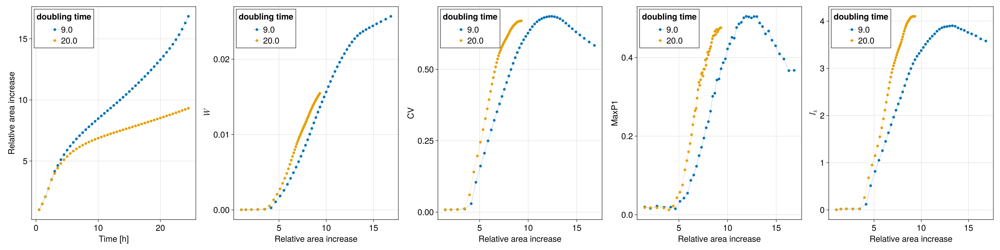

In [ ]:
fig7 = Figure(size = (2400, 600))
ax = Axis(fig7[1,1], ylabel = "Relative area increase", xlabel = "Time [h]")
ax2 = Axis(fig7[1,2], ylabel = L"W", xlabel = "Relative area increase")
ax3 = Axis(fig7[1,3], ylabel = "CV", xlabel = "Relative area increase")
ax4 = Axis(fig7[1,4], ylabel = "MaxP1", xlabel = "Relative area increase")
ax5 = Axis(fig7[1,5], ylabel = L"I_k", xlabel = "Relative area increase")

samp_fac = data_used.sampling_interval[1] /3600

for (i,p) in enumerate(para_range)
    metric_single =angular_metric_vec[i]

    

    # normalize by area 
    
    scatterlines!(ax, (1:length(datu)).*samp_fac, area_gain_vec[i], linewidth = .3, label= doubling_time[i]) 
    scatterlines!(ax2, area_gain_vec[i],[roughness(x,Og_size) for x in metric_single], linewidth = .3, label= doubling_time[i]) 
  
    #if i < 5
        scatterlines!(ax3, area_gain_vec[i], [std(x)/mean(x) for x in metric_single][1:end], linewidth = .3, label= doubling_time[i]) 
        scatterlines!(ax4, area_gain_vec[i], [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][1:end], linewidth = .3, label= doubling_time[i]) 
    #else
    """

        "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))"

        scatterlines!(ax3, (5:length(datu)).*(1/3), [std(x)/mean(x) for x in metric_single][5:end], linewidth = .3, label= "$(p)_CV")
        scatterlines!(ax4, (5:length(datu)).*(1/3), [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][5:end], linewidth = .3, label= "$(p)_MaxP1")
      """
    scatterlines!(ax5, area_gain_vec[i], [fourier_ik(x,Og_size) for x in metric_single]./area_gain_vec[i], linewidth = .3, label= doubling_time[i]) 
end

axislegend(ax, "doubling time", position = :lt)
axislegend(ax2, "doubling time", position = :lt)
axislegend(ax3, "doubling time", position = :lt)
axislegend(ax4, "doubling time", position = :lt)
axislegend(ax5, "doubling time", position = :lt)

save(data_used.path[1]*"\\analysis\\roughness_area_n.png", fig7)
fig7

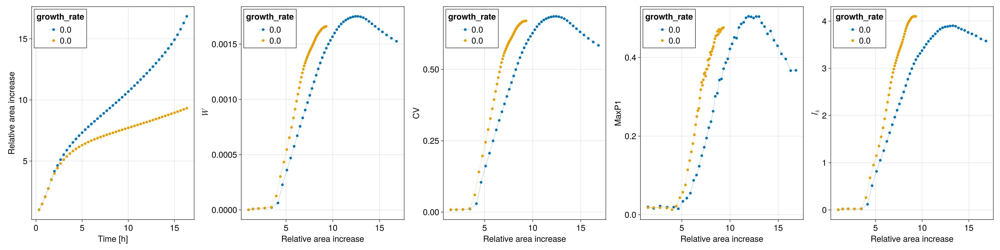

In [ ]:
fig7 = Figure(size = (2400, 600))
ax = Axis(fig7[1,1], ylabel = "Relative area increase", xlabel = "Time [h]")
ax2 = Axis(fig7[1,2], ylabel = L"W", xlabel = "Relative area increase")
ax3 = Axis(fig7[1,3], ylabel = "CV", xlabel = "Relative area increase")
ax4 = Axis(fig7[1,4], ylabel = "MaxP1", xlabel = "Relative area increase")
ax5 = Axis(fig7[1,5], ylabel = L"I_k", xlabel = "Relative area increase")
for (i,p) in enumerate(para_range)
    metric_single =angular_metric_vec[i]



    
    # normalize by area 
    
    scatterlines!(ax, (1:length(datu)).*(1/3), area_gain_vec[i], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))") 
    scatterlines!(ax2, area_gain_vec[i],[roughness(x,Og_size) for x in metric_single]./area_gain_vec[i], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
  
    #if i < 5
        scatterlines!(ax3, area_gain_vec[i], [std(x)/mean(x) for x in metric_single][1:end], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
        scatterlines!(ax4, area_gain_vec[i], [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][1:end], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
    #else
    """

        "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))"

        scatterlines!(ax3, (5:length(datu)).*(1/3), [std(x)/mean(x) for x in metric_single][5:end], linewidth = .3, label= "$(p)_CV")
        scatterlines!(ax4, (5:length(datu)).*(1/3), [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][5:end], linewidth = .3, label= "$(p)_MaxP1")
      """
    scatterlines!(ax5, area_gain_vec[i], [fourier_ik(x,Og_size) for x in metric_single]./area_gain_vec[i], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
end
axislegend(ax,"$(s_p)", position = :lt)
axislegend(ax2,"$(s_p)", position = :lt)
axislegend(ax3,"$(s_p)", position = :lt)
axislegend(ax4,"$(s_p)", position = :lt)
axislegend(ax5,"$(s_p)",position = :lt)

save(data_used.path[1]*"\\analysis\\roughness_area_n.png", fig7)
fig7

In [ ]:
round(data_used.parameter_increment[1]*(3-1)+data_used[!,s_p][1], digits = 2)

-0.0

In [ ]:
round(data_used.parameter_increment[1]*(3-1)+data_used[!,s_p][1], digits =2)

-0.0

In [ ]:
round(10.12321, digits = 2)

10.12

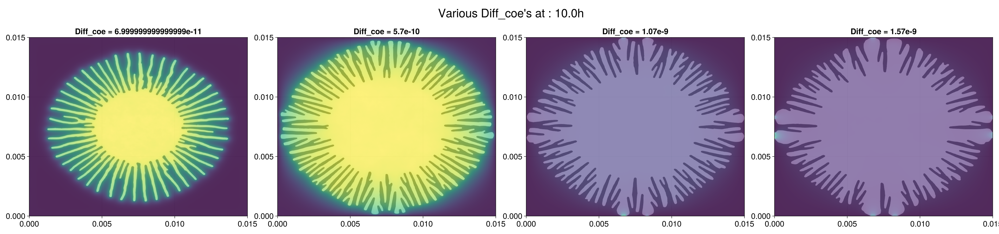

In [ ]:
size = res_scaling(length(para_range), factor = 3 , plots = 1)
fig7 = Figure(size = size)
c = 0
for p in para_range
    data = s.deserialize(path_vec[1][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig7[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
end

supertitle = Label(fig7[0, :], "Various $(s_p)'s at : $(time_point *data_used.sampling_interval[1]/3600)h", fontsize = 30)
#supertitle = Label(fig7[0, :], "Various α  at timesteps: $(time_point *data_used.sampling_interval[1])", fontsize = 30)
display(fig7)

save(data_used.path[1]*"\\analysis\\final_state.png", fig7)
#mkpath(data_used.path[1]*"\\analysis")
#save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_area__cells_adsorbed.png", fig5, size = size)